In [2]:
import cv2
import os
# import natsort
import matplotlib.pyplot as plt
import numpy as np
import json
import random
%matplotlib inline 
from mpl_toolkits.mplot3d import Axes3D
from sklearn.mixture import GaussianMixture
from sklearn.cluster import KMeans, DBSCAN
from sklearn.metrics import davies_bouldin_score, calinski_harabasz_score,silhouette_score

# from google.colab import drive
# drive.mount('/content/gdrive')

#####  In order to replicate the results, download the databes from kaggle and specify the correct path within the next cell.

In [3]:
cars_path = "cars_train"  
path_meta = 'metadata'
names_cars = os.listdir(cars_path)

if not os.path.exists(path_meta):
    os.mkdir(path_meta)
    
paths_cars = [os.path.join(cars_path, name) for name in names_cars]

# Matching de Productos

##### The number of keypoints that are created can be change, our default selection is  500

In [4]:
orb = cv2.ORB_create(500)
bfmatcher = cv2.BFMatcher(normType = cv2.NORM_HAMMING, crossCheck = True)

## Descriptors Functions

In [5]:
def get_metadata(car_name):
    car_metadata_name = os.path.join(path_meta, car_name)

    if os.path.exists(car_metadata_name):
        with open(car_metadata_name) as f:
            metadata = json.load(f)
            return [metadata]
    else:
        return []

In [6]:
def get_descriptors(img, bins, path):
    
    car_name = path.split('.')[0].split('\\')[1] + '.json'
    metadat =   get_metadata(car_name)

    if len(metadat) > 0:
        data = metadat[0]
        
        hist_concat = np.array(data['hist'],np.float32)
        des = np.array(data['des'], dtype=np.uint8)

    else:
        car_metadata_json = {}
        
        #histograms
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img_hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
        img_lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)

        hist_rgb, hist_hsv, hist_lab = [],[],[]
        for c in range(3):
            hist_rgb0 = cv2.calcHist([img_rgb], [c], None, [bins],[0, 256])
            hist_rgb0 = cv2.normalize(hist_rgb0, hist_rgb0).flatten()
            hist_rgb.append(hist_rgb0)

            hist_hsv0 = cv2.calcHist([img_hsv], [c], None, [bins],[0, 256])
            hist_hsv0 = cv2.normalize(hist_hsv0, hist_hsv0).flatten()
            hist_hsv.append(hist_hsv0)

            hist_lab0 = cv2.calcHist([img_lab], [c], None, [bins],[0, 256])
            hist_lab0 = cv2.normalize(hist_lab0, hist_lab0).flatten()
            hist_lab.append(hist_lab0)

        hist_concat = np.concatenate([hist_rgb, hist_hsv, hist_lab],axis=0)
        car_metadata_json['hist'] = hist_concat.tolist()


        #obr
        kp, des = orb.detectAndCompute(img, None)
        car_metadata_json['des'] = des.tolist()

        with open(os.path.join(path_meta, car_name), 'w') as f:
            json.dump(car_metadata_json, f)

    return hist_concat, des
        

    

In [7]:
def read_and_calculate(paths, bins):
    histogram_descrp = []
    obs_dscrp = []
    images=[]
       

    for i, pth in enumerate(paths):

        img = cv2.imread(pth)
        
    
        if img is not None:

            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            img = cv2.resize(img, dsize=(480, 480))
            images.append(img)
            
            
            # get descriptors (histograms and keypoints matrixes with ORB)
            hist_concat, des = get_descriptors(img, bins, pth)
            
            
            histogram_descrp.append(hist_concat.copy())
            obs_dscrp.append(des.copy())

    histogram_descarr = np.array(histogram_descrp)
    return histogram_descarr, obs_dscrp, images   
            


In [8]:
def get_match():
    
    for ni, img_i in enumerate(imgs_dataset):
        
        score_distances = []
        for nj, img_j in enumerate(imgs_dataset):
            if ni!=nj:
        
                # MATCH OF KEAYPOINTS
                ## (descriptor reference, descriptor ddbb)
                
                matches = bfmatcher.match(obs_dataset[ni], obs_dataset[nj])
                matches = sorted(matches, key = lambda x: x.distance)

                distances = [m.distance for m in matches] 
                score_distances.append((np.mean(distances), nj))
                
        ## The scores are stored within a tuple containing the resulting distance and idenfificator of the image.
        ## They are sorted with respect the distance
        scores_sorted = sorted(score_distances, key=lambda tup: tup[0])[:10]

        # HISTOGRAM
        results_channels, distances_all = [],[]
        for n, scores in enumerate(scores_sorted):
            for nc in range(np.array(hist_dataset).shape[1]):

                distance = cv2.compareHist(hist_dataset[ni][nc], hist_dataset[scores[1]][nc], cv2.HISTCMP_CHISQR) 
                distances_all.append(distance)

            results_channels.append((np.mean(distances_all), scores[1], scores[0]))
    

        results_sorted = sorted(results_channels, key=lambda tup: tup[0])[::-1][:5]

      
        for nbest in results_sorted:
            # PLOT
            plt.subplot(121)
            plt.imshow(imgs_dataset[ni])
            plt.subplot(122)
            plt.imshow(imgs_dataset[nbest[1]])
            plt.show()
            print('\n\n\n')
  


# Matching

In [9]:
%%time
hist_dataset, obs_dataset, imgs_dataset = read_and_calculate(paths_cars, 8)

CPU times: total: 1min 53s
Wall time: 1min 15s


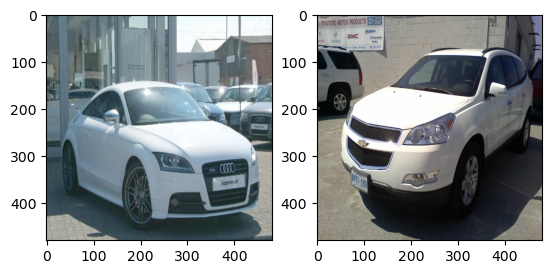

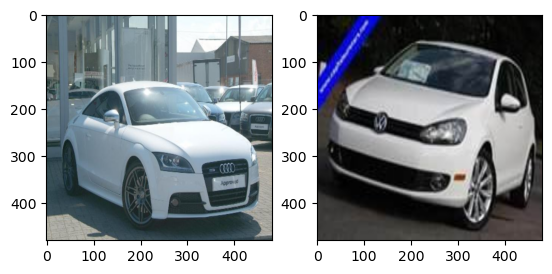

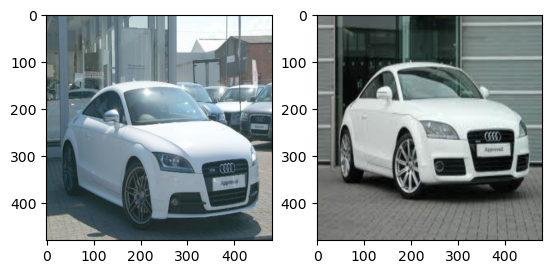

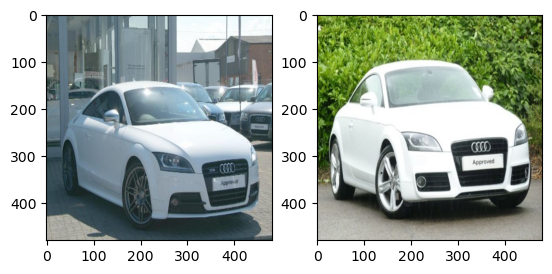

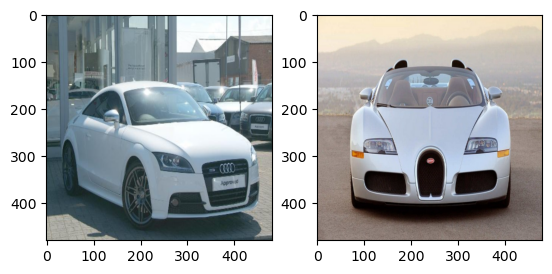

...

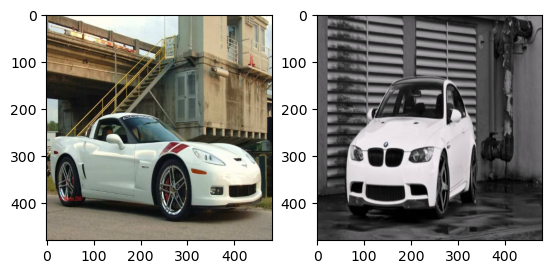

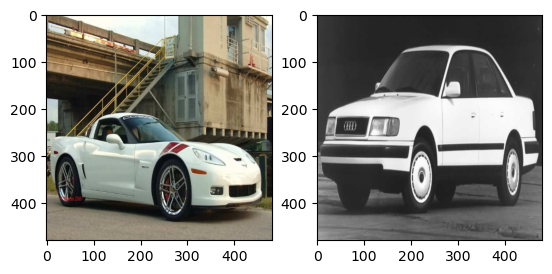

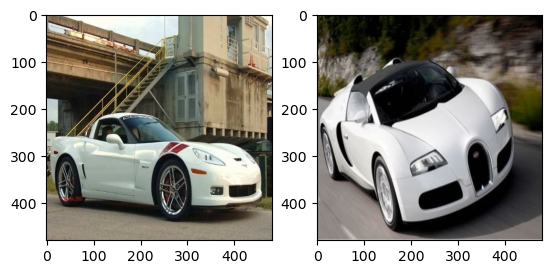

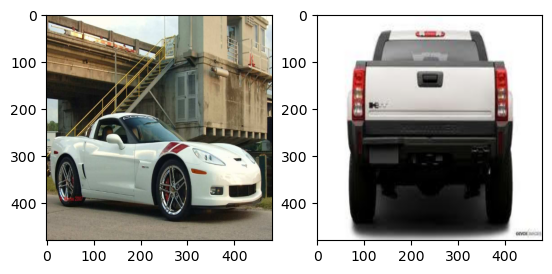

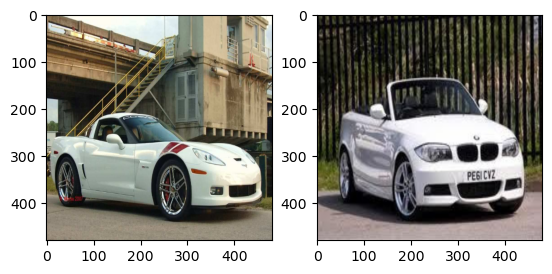

KeyboardInterrupt: 

In [10]:
get_match()